# Capstone

For our capstone we constructed a machine learning model that could predict if there is a tumor using brain MRI scans as our inputs. The dataset we will be using can be found on Kaggle. We had an original data size of 253 MRI scans. We did some data augmentation and were able increase our data size to 1012 images. For our model we used a convolutional neural network. our model had an average of about 90% accuracy that is still being tested along with multiple other aspects of our dataset. 

## Libraries

Inlcuded below are all of the libraries that were used throughout this program formatted in the exact order in which they were used.

In [1]:
# Import libraries
import pathlib
import tensorflow as tf
import PIL
from PIL import Image, ImageOps
import cv2
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import random
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import seaborn as sns

## Loading Data

The dataset used was extracted from Kaggle's open datasets. Before running the code we need to upload our Kaggle API token through the file uploader within Google Colab. We then start off by initializing a directory to store our kaggle json file. From here, we are able to directly download our dataset straight from kaggle without downloading it onto our own system/computer. We finish off by unzipping the folders and extracting each individual file into our notebook directory.

In [2]:
# creates dir for kaggle 
! chmod 600 kaggle.json && (ls ~/.kaggle 2>/dev/null || mkdir ~/.kaggle) && mv kaggle.json ~/.kaggle/ && echo 'Done'

Done


In [3]:
# Download Data
!kaggle datasets download navoneel/brain-mri-images-for-brain-tumor-detection
!ls

 60% 9.00M/15.1M [00:00<00:00, 94.0MB/s]
100% 15.1M/15.1M [00:00<00:00, 96.5MB/s]
brain-mri-images-for-brain-tumor-detection.zip	sample_data


In [4]:
#unzip folders
!unzip brain-mri-images-for-brain-tumor-detection.zip

Archive:  brain-mri-images-for-brain-tumor-detection.zip
  inflating: brain_tumor_dataset/no/1 no.jpeg  
  inflating: brain_tumor_dataset/no/10 no.jpg  
  inflating: brain_tumor_dataset/no/11 no.jpg  
  inflating: brain_tumor_dataset/no/12 no.jpg  
  inflating: brain_tumor_dataset/no/13 no.jpg  
  inflating: brain_tumor_dataset/no/14 no.jpg  
  inflating: brain_tumor_dataset/no/15 no.jpg  
  inflating: brain_tumor_dataset/no/17 no.jpg  
  inflating: brain_tumor_dataset/no/18 no.jpg  
  inflating: brain_tumor_dataset/no/19 no.jpg  
  inflating: brain_tumor_dataset/no/2 no.jpeg  
  inflating: brain_tumor_dataset/no/20 no.jpg  
  inflating: brain_tumor_dataset/no/21 no.jpg  
  inflating: brain_tumor_dataset/no/22 no.jpg  
  inflating: brain_tumor_dataset/no/23 no.jpg  
  inflating: brain_tumor_dataset/no/24 no.jpg  
  inflating: brain_tumor_dataset/no/25 no.jpg  
  inflating: brain_tumor_dataset/no/26 no.jpg  
  inflating: brain_tumor_dataset/no/27 no.jpg  
  inflating: brain_tumor_datase

---

## Exploratory Data Analysis

Here you will see how we explored our data and gathered some details and information that would help us make decisions in further aspects of the program. We use all of the file paths and directories to store the path for each image and use this to count how many images we have in total in under which subcategory. We then display a set of random images from each dataset to simply view our data and get an understanding of what we will be working with. The most useful image analysis we did was in regards to the dimensions and we simply store the average dimensions to use later on in our decision for rescaling.

In [5]:
# store file paths for each image from a directory
all_data_dir = pathlib.Path('/content/brain_tumor_dataset')
yes_dir = pathlib.Path('/content/brain_tumor_dataset/yes')
no_dir = pathlib.Path('/content/brain_tumor_dataset/no')

In [6]:
# Explore directories
image_count = len(list(all_data_dir.glob('*/*')))
print('Total MRI Brain Scans: ', image_count)
dataCount = len(list(all_data_dir.glob('*')))
print('Classes: ', dataCount)
yesCount = len(list(yes_dir.glob('*')))
print('Tumor MRI: ', yesCount)
noCount = len(list(no_dir.glob('*')))
print('Normal MRI: ', noCount)

Total MRI Brain Scans:  253
Classes:  2
Tumor MRI:  155
Normal MRI:  98


In [7]:
# store images from directories into image_iterator
image_iterator = tf.keras.preprocessing.image.DirectoryIterator(
    directory=all_data_dir,
    batch_size=128,
    image_data_generator=None)

Found 253 images belonging to 2 classes.


NORMAL


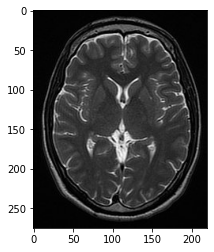

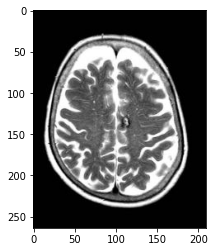

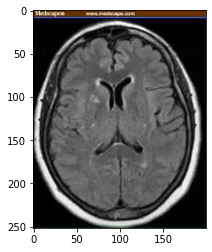

<Figure size 432x288 with 0 Axes>

In [8]:
# Plot sample image from normal MRI data
arr = image_iterator.filepaths
print('NORMAL')
for i in range(3):
  rand = random.randint(0, len(arr)-1)
  while 'no' not in arr[rand]:
    rand = random.randint(0, len(arr)-1)
  image = cv2.imread(arr[rand])
  plt.imshow(image)
  plt.figure()
  

TUMORS


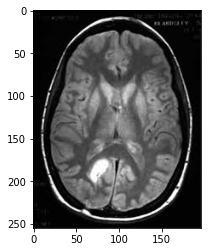

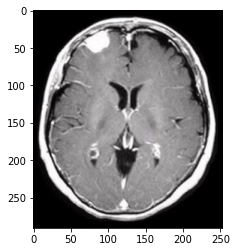

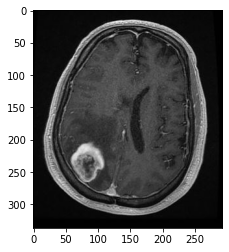

<Figure size 432x288 with 0 Axes>

In [9]:
# Plot sample images from tumor data
print('TUMORS')
for i in range(3):
  rand = random.randint(0, len(arr)-1)
  while 'yes' not in arr[rand]:
    rand = random.randint(0, len(arr)-1)
  image = cv2.imread(arr[rand])
  plt.imshow(image)
  plt.figure()

In [10]:
# gather dimensions and find min, max, and mean
length_dims = list()
width_dims = list()
for i in range(len(arr)):
  image = plt.imread(arr[i])
  dims = np.shape(image)
  length_dims.append(dims[0])
  width_dims.append(dims[1])
ave_length, ave_width = int(np.mean(length_dims)), int(np.mean(width_dims))
print('Min dimensions: ', np.min(length_dims), np.min(width_dims))
print('Max dimensions: ', np.max(length_dims), np.max(width_dims))
print('Average dimensions: ', ave_length, ave_width)

Min dimensions:  168 150
Max dimensions:  1427 1920
Average dimensions:  386 354


MIXED


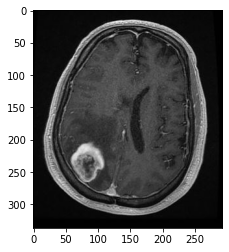

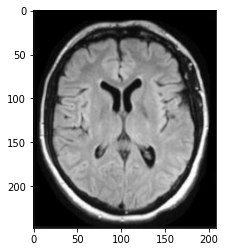

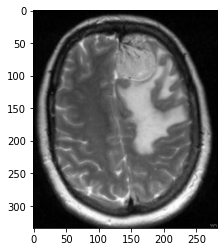

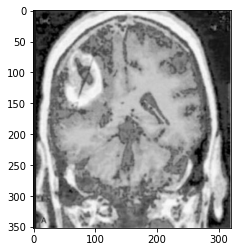

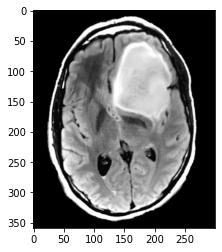

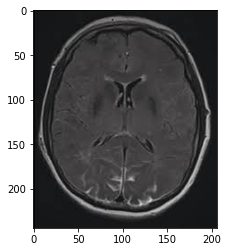

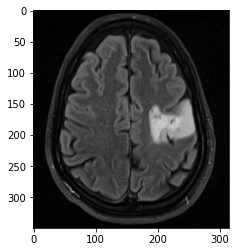

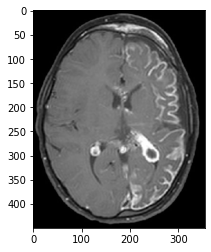

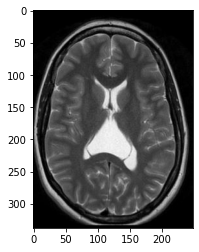

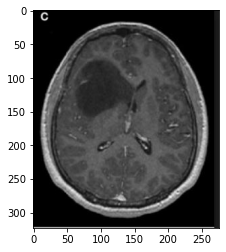

<Figure size 432x288 with 0 Axes>

In [11]:
# Plot sample images of overall data as a whole
print('MIXED')
for i in range(10):
  rand = random.randint(0, len(arr)-1)
  image = cv2.imread(arr[rand])
  plt.imshow(image)
  plt.figure()

## Data Augmentation

For our data augmentation we begin by resizing, flipping, mirroring, and rotating the image. We save each version of our data augmentation and add to our dataset in order to increase our overall data. We then continue with converting each image to grayscale and gathering contours for masking. The mask outlines the perimeter of the brain to allow the model to forget about the background. Once the we outline the brain, we will then zero out the rest of the pixels surrounding the brain which will help the accurady when normalizing the data. These images end up overwriting each of our previosuly augmentated data and do not actually increase our dataset.

In [12]:
# Iterate through each image and augmentate then save each variation as well 
# as overwrite the original
target_height = ave_length
target_width = ave_width

for i in arr: 
  image = i
  img = PIL.Image.open(image)
  img = img.convert('RGB')
  img = img.resize((target_height, target_width), Image.ANTIALIAS)

  flip = ImageOps.flip(img)
  mirror = ImageOps.mirror(img)
  rotate180 = img.rotate(180)

  new = i.strip('.jpeg')
  new = new.strip('.jpg')
  new = new.strip('.JPG')
  new = new.strip('.png')

  flip_name = new + '-flipped.jpeg'
  mirror_name = new + '-mirror.jpeg'
  rotate180_name = new + '-rotate-180.jpeg'

  flip.save(flip_name)
  mirror.save(mirror_name)
  rotate180.save(rotate180_name)

  img.save(i)


AUGMENTED


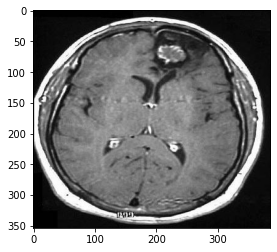

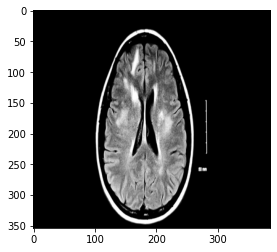

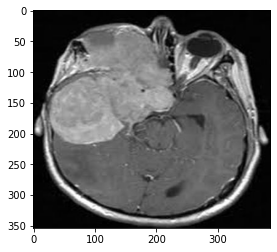

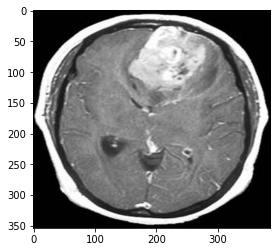

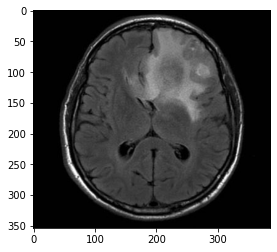

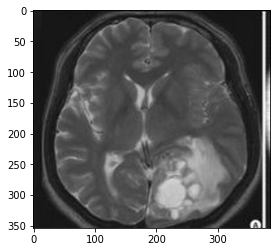

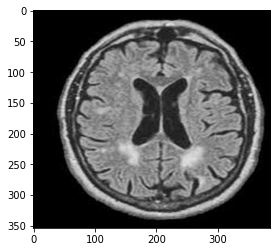

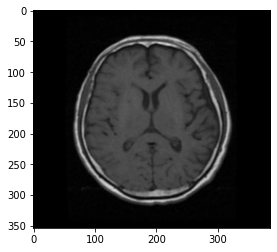

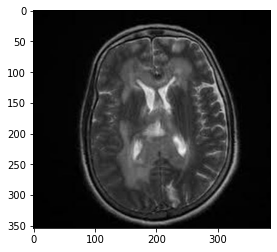

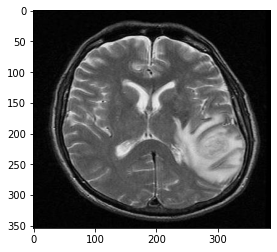

<Figure size 432x288 with 0 Axes>

In [13]:
# Plot sample images of augmented data
print('AUGMENTED')
for i in range(10):
  rand = random.randint(0, len(arr)-1)
  image = cv2.imread(arr[rand])
  plt.imshow(image)
  plt.figure()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


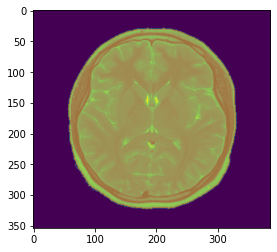

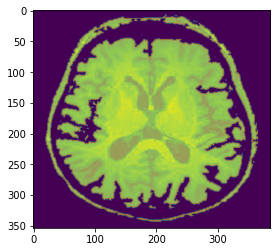

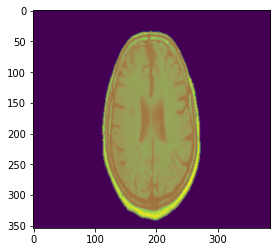

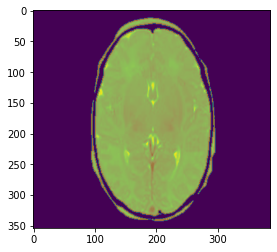

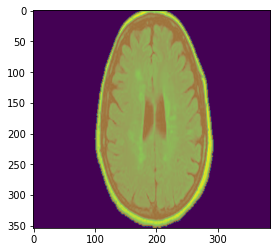

...

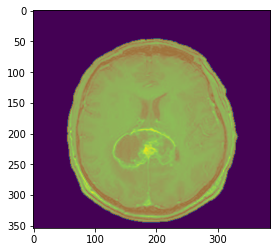

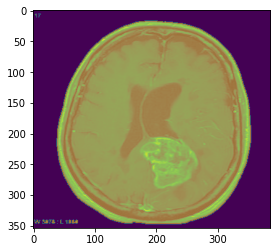

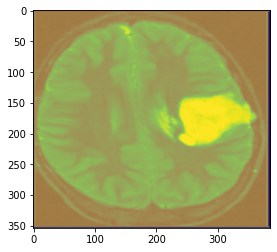

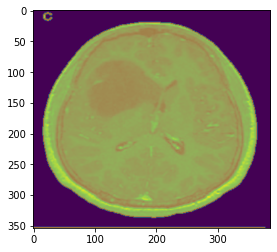

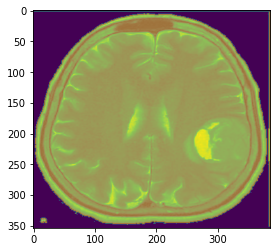

<Figure size 432x288 with 0 Axes>

In [14]:
for i in arr:
  image = cv2.imread(i)
  
  # Grayscale
  gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  mask = np.zeros_like(gray)
  ret, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY)
  contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
  contours, hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
  cv2.drawContours(gray,contours,-1,(0,255,0),2)

  # applying mask to image
  cv2.fillPoly(mask, pts=contours, color=(255,255,255))
  gray[mask==0] = 0 

  # Data
  img = np.expand_dims(gray, axis=2)
  cv2.imwrite(i, img)
  plt.imshow(gray)
  plt.imshow(mask, alpha=.5)
  plt.figure()


AUGMENTED


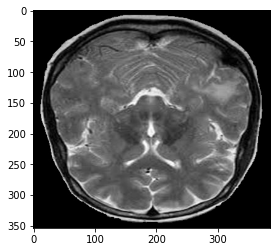

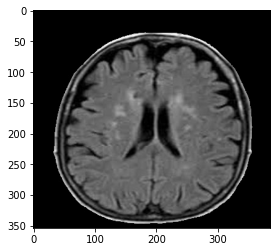

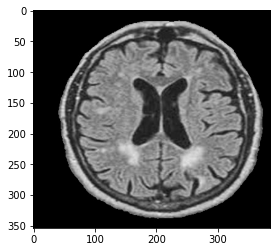

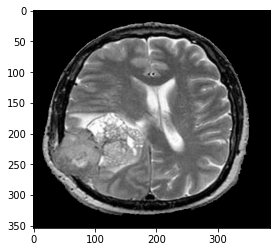

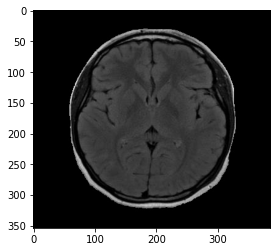

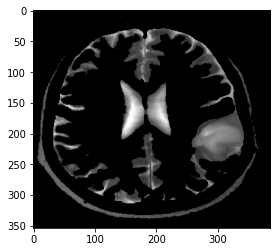

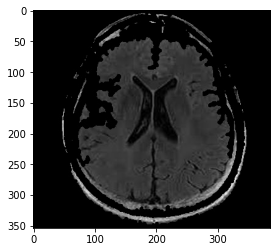

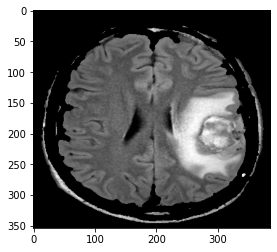

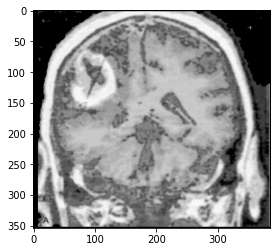

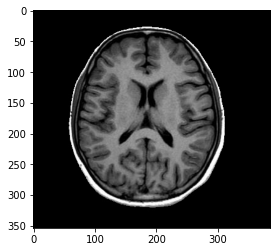

<Figure size 432x288 with 0 Axes>

In [15]:
# Plot sample images of further augmented data
print('AUGMENTED')
for i in range(10):
  rand = random.randint(0, len(arr)-1)
  image = cv2.imread(arr[rand])
  plt.imshow(image)
  plt.figure()

## Splitting Data

In order to split our data in train and test dataset, we used an iterator method that goes through a directory and splits all of our image files into the desired ratio. We double check everything here by checking data size as well as label size. We also analyze our variables and look at our possible labels and plotting a sample of our data along with labels.

In [16]:
# store images from directories into image_iterator
image_iterator = tf.keras.preprocessing.image.DirectoryIterator(
    directory=all_data_dir,
    batch_size=128,
    image_data_generator=None)

Found 1009 images belonging to 2 classes.


In [17]:
# Set split size 
split_size = .2
batch_size = np.round(image_iterator.n * split_size)
print('Estimated test size: ', batch_size)

Estimated test size:  202.0


In [18]:
# split training dataset
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  all_data_dir,
  validation_split=split_size,
  subset="training",
  seed=123,
  image_size=(target_height, target_width),
  batch_size=batch_size)

Found 1009 files belonging to 2 classes.
Using 808 files for training.


In [19]:
# training dataset label size
train_labels = np.concatenate([y for x, y in train_ds], axis=0)
print('Training labels size: ', train_labels.size)

Training labels size:  808


In [20]:
#split testing dataset
test_ds = tf.keras.preprocessing.image_dataset_from_directory(
  all_data_dir,
  validation_split=split_size,
  subset="validation",
  seed=123,
  image_size=(target_height, target_width),
  batch_size=batch_size)

Found 1009 files belonging to 2 classes.
Using 201 files for validation.


In [21]:
# testing dataset label size
test_labels = np.concatenate([y for x, y in test_ds], axis=0)
print('Testing labels size: ', test_labels.size)

Testing labels size:  201


In [22]:
# Label possibilites
class_names = train_ds.class_names
print('train class names =', class_names)
class_names = test_ds.class_names
print('test class names =', class_names)

train class names = ['no', 'yes']
test class names = ['no', 'yes']


In [23]:
# 0 is no tumor
# 1 is tumor
print('Labels: ', test_labels)

Labels:  [1 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 0 0
 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 1 1
 0 1 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0
 0 1 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1
 1 0 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1 1
 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 1]


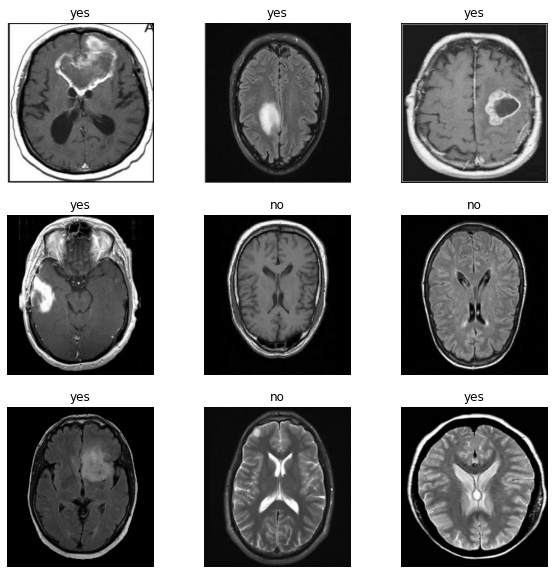

In [24]:
# plot training images along with their respective labels
image_batch, label_batch = next(iter(train_ds))

plt.figure(figsize=(10, 10))
for i in range(9):
  ax = plt.subplot(3, 3, i + 1)
  img = image_batch[i].numpy()
  plt.imshow(img.astype("uint8"))
  label = label_batch[i]
  plt.title(class_names[label])
  plt.axis("off")

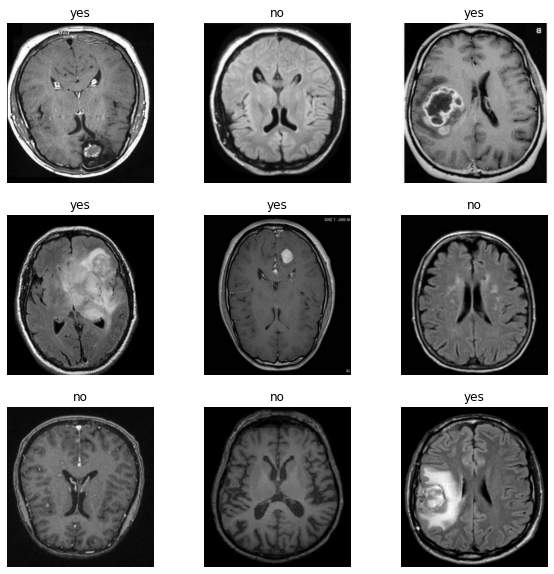

In [25]:
# plot testing images along with their respective labels
test_image_batch, test_label_batch = next(iter(test_ds))

plt.figure(figsize=(10, 10))
for i in range(9):
  ax = plt.subplot(3, 3, i + 1)
  img = test_image_batch[i].numpy()
  plt.imshow(img.astype("uint8"))
  label = test_label_batch[i]
  plt.title(class_names[label])
  plt.axis("off")

## Build And Train Model

Our machine learning model is constructed as a Convolutional Nueral Network. Since we are working with images. The first layer includes our input shape as well as normalizes the images being ran through the model all at once. Each layer after follows a similar pattern with convolutional layers and maxpooling layers. Since we are only working with the two possibilities of there being a tumor or not, we ended up using binary crossentropy. We also implemented and early stopping method for when we run our epochs. Most of our model stuck with the original initiliazing parameters.

In [26]:
# Add layers for our model
num_classes = 1

model = Sequential([
  layers.experimental.preprocessing.Rescaling(1./255, input_shape=(target_height, target_width, 3)),
  layers.Conv2D(16, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(128, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(256, activation='relu'),
  layers.Dense(num_classes, activation='sigmoid')
])

In [27]:
# compile model using binary crossentropy
model.compile(optimizer='adam',
              loss=tf.keras.losses.BinaryCrossentropy(),
              metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 386, 354, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 386, 354, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 193, 177, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 193, 177, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 96, 88, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 96, 88, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 48, 44, 64)        0

In [28]:
# set up early stopping
early_stop = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience= 20)

In [29]:
# Fit the model with our datasets and implement early stopping
epochs=100

history = model.fit(
  train_ds,
  validation_data=test_ds,
  epochs=epochs,
  callbacks=early_stop
)

Epoch 1/100
4/4 [==============================] - 22s 979ms/step - loss: 1.1800 - accuracy: 0.5767 - val_loss: 0.5382 - val_accuracy: 0.7662
Epoch 2/100
4/4 [==============================] - 3s 524ms/step - loss: 0.5159 - accuracy: 0.7661 - val_loss: 0.5161 - val_accuracy: 0.7761
Epoch 3/100
4/4 [==============================] - 3s 526ms/step - loss: 0.4975 - accuracy: 0.7797 - val_loss: 0.5012 - val_accuracy: 0.7960
Epoch 4/100
4/4 [==============================] - 3s 526ms/step - loss: 0.4659 - accuracy: 0.8045 - val_loss: 0.4691 - val_accuracy: 0.8010
Epoch 5/100
4/4 [==============================] - 3s 530ms/step - loss: 0.4370 - accuracy: 0.8230 - val_loss: 0.4644 - val_accuracy: 0.8159
Epoch 6/100
4/4 [==============================] - 3s 528ms/step - loss: 0.4004 - accuracy: 0.8243 - val_loss: 0.4177 - val_accuracy: 0.8358
Epoch 7/100
4/4 [==============================] - 3s 529ms/step - loss: 0.3614 - accuracy: 0.8527 - val_loss: 0.4408 - val_accuracy: 0.8358
Epoch 8/100


## Checking Model Accuracy

In this section, we track and track our model's accuracy and loss values for both training and testing data. The graph uses all of the information from the epochs earlier and creates an easy to follow visual to understand how our model is working. At the end we also see the overall accuracy and summary of the model as a whole.

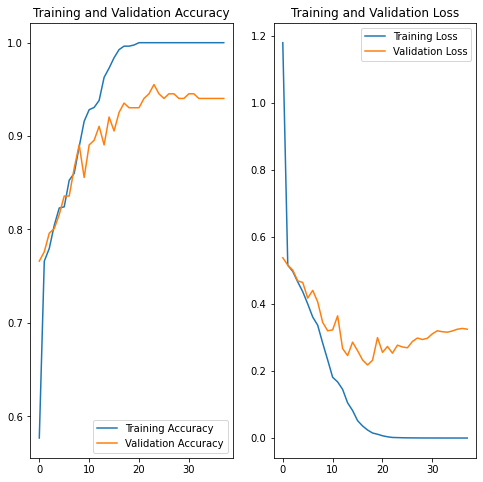

In [30]:
# Plot accuracy and loss history from epochs
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(len(history.epoch))

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [31]:
# evaluate model with testing dataset
print(model.evaluate(test_ds))

1/1 [==============================] - 0s 423ms/step - loss: 0.3249 - accuracy: 0.9403
[0.32493913173675537, 0.9402984976768494]


## Predictions

Finally, we can run our images into our model and recieve predictions. The system implemented below plots the images and shows the predictions versus the original label. We also plot all of the images that were misclassified to see what is causing the errors. The classification report shows a more detailed description of how our model is performing for each prediction possibility. We almost always have a higher accuracy rate for images without tumors. Lastly, we included a confusion matrix that gives us the amount of false positives, false negatives, true positives, and true negatives. This ties everything together and shows just how accurate our model has performed.

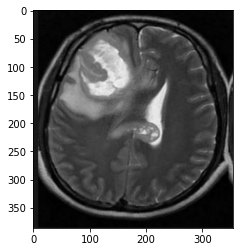

Prediction: TUMOR DETECTED
Original: TUMOR PRESENT


In [32]:
# Plot image along with predictions and label
image_batch, label_batch = next(iter(test_ds))

num = random.randint(0, len(image_batch)-1)
plt.imshow(image_batch[num].numpy().astype('uint8'))
plt.show()
predictions = model.predict(image_batch)
rounded_predictions = abs(np.round(predictions + .25))

if int(rounded_predictions[num][0]) is int(0):
  print('Prediction: NO TUMOR DETECTED')
else:
  print(('Prediction: TUMOR DETECTED'))

if int(label_batch[num].numpy()) is int(0):
  print('Original: NO TUMOR PRESENT')
else:
  print('Original: TUMOR PRESENT')


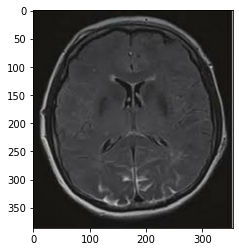

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


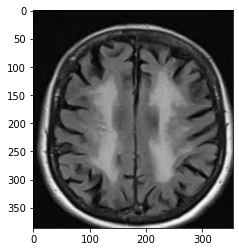

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


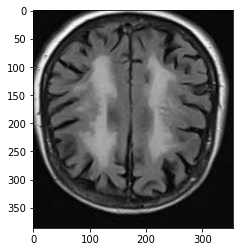

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


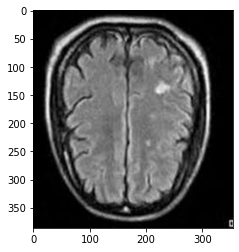

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


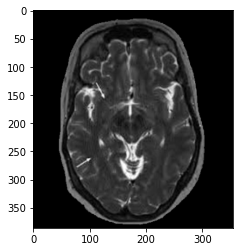

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


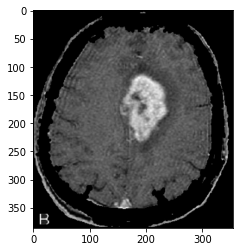

Prediction: NO TUMOR DETECTED
Original: TUMOR PRESENT


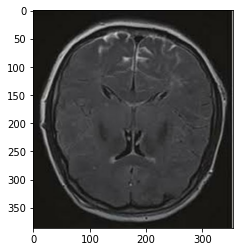

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


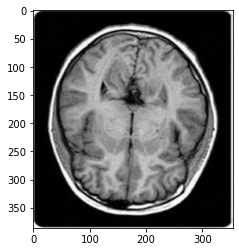

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


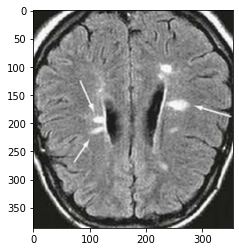

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


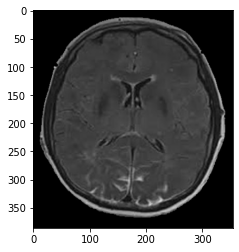

Prediction: TUMOR DETECTED
Original: NO TUMOR PRESENT


In [33]:
# Plot image along with predictions and label that were misclassified
image_batch, label_batch = next(iter(test_ds))
predictions = model.predict(image_batch)
rounded_predictions = abs(np.round(predictions + .25))

for i in range(len(image_batch)-1):
  if int(rounded_predictions[i][0]) != int(label_batch[i].numpy()):
    plt.imshow(image_batch[i].numpy().astype('uint8'))
    plt.show()
    if int(rounded_predictions[i][0]) is int(0):
      print('Prediction: NO TUMOR DETECTED')
    else:
      print(('Prediction: TUMOR DETECTED'))

    if int(label_batch[i].numpy()) is int(0):
      print('Original: NO TUMOR PRESENT')
    else:
      print('Original: TUMOR PRESENT')


In [34]:
# classification report
print('classification report:')
print(classification_report(label_batch, rounded_predictions))

classification report:
              precision    recall  f1-score   support

           0       0.99      0.89      0.94        83
           1       0.93      0.99      0.96       118

    accuracy                           0.95       201
   macro avg       0.96      0.94      0.95       201
weighted avg       0.95      0.95      0.95       201



confusion matrix:


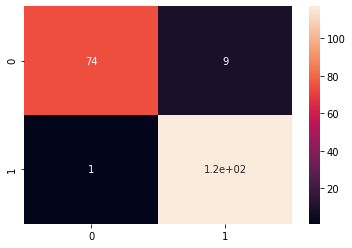

In [35]:
#confusion matrix
print('confusion matrix:')
cm = confusion_matrix(label_batch, rounded_predictions)
sns.heatmap(cm, xticklabels=[0, 1], yticklabels=[0,1], annot=True)